### Airline customer segmentation (Kmeans)

In [34]:
# Import the necessary libraries
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import  PCA
import seaborn as sns
from sklearn.cluster import KMeans

In [35]:
import warnings
warnings.filterwarnings('ignore')

In [36]:
# Load or read the dataset
data = pd.read_csv("C:/Sudhakar/Dataset/Airline customer segmentation/flight_train.csv")

In [37]:
data.head()

,MEMBER_NO,FFP_DATE,FIRST_FLIGHT_DATE,GENDER,FFP_TIER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY,AGE,LOAD_TIME,...,SUM_YR_2,SEG_KM_SUM,LAST_FLIGHT_DATE,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
0,54993,11/2/2006,12/24/2008,Male,6,.,beijing,CN,31.0,3/31/2014,...,234188.0,580717,3/31/2014,1,3.483254,18,34,0.961639,619760,50
1,28065,2/19/2007,8/3/2007,Male,6,NaN,beijing,CN,42.0,3/31/2014,...,167434.0,293678,3/25/2014,7,5.194245,17,29,1.252314,415768,33
2,55106,2/1/2007,8/30/2007,Male,6,.,beijing,CN,40.0,3/31/2014,...,164982.0,283712,3/21/2014,11,5.298507,18,20,1.254676,406361,26
3,21189,8/22/2008,8/23/2008,Male,5,Los Angeles,CA,US,64.0,3/31/2014,...,125500.0,281336,12/26/2013,97,27.863636,73,11,1.090870,372204,12
4,39546,4/10/2009,4/15/2009,Male,6,guiyang,guizhou,CN,48.0,3/31/2014,...,130702.0,309928,3/27/2014,5,4.788079,47,27,0.970658,338813,39


In [38]:
data.shape

(55000, 23)

In [39]:
data.columns

Index(['MEMBER_NO', 'FFP_DATE', 'FIRST_FLIGHT_DATE', 'GENDER', 'FFP_TIER',
       'WORK_CITY', 'WORK_PROVINCE', 'WORK_COUNTRY', 'AGE', 'LOAD_TIME',
       'FLIGHT_COUNT', 'BP_SUM', 'SUM_YR_1', 'SUM_YR_2', 'SEG_KM_SUM',
       'LAST_FLIGHT_DATE', 'LAST_TO_END', 'AVG_INTERVAL', 'MAX_INTERVAL',
       'EXCHANGE_COUNT', 'avg_discount', 'Points_Sum', 'Point_NotFlight'],
      dtype='object')

In [40]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55000 entries, 0 to 54999
Data columns (total 23 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   MEMBER_NO          55000 non-null  int64  
 1   FFP_DATE           55000 non-null  object 
 2   FIRST_FLIGHT_DATE  55000 non-null  object 
 3   GENDER             54997 non-null  object 
 4   FFP_TIER           55000 non-null  int64  
 5   WORK_CITY          53034 non-null  object 
 6   WORK_PROVINCE      52216 non-null  object 
 7   WORK_COUNTRY       54980 non-null  object 
 8   AGE                54658 non-null  float64
 9   LOAD_TIME          55000 non-null  object 
 10  FLIGHT_COUNT       55000 non-null  int64  
 11  BP_SUM             55000 non-null  int64  
 12  SUM_YR_1           54738 non-null  float64
 13  SUM_YR_2           54937 non-null  float64
 14  SEG_KM_SUM         55000 non-null  int64  
 15  LAST_FLIGHT_DATE   55000 non-null  object 
 16  LAST_TO_END        550

In [41]:
data['LOAD_TIME']   # data format is object so we need to convert it to datetime
date_list = ['FFP_DATE', 'FIRST_FLIGHT_DATE', 'LOAD_TIME','LAST_FLIGHT_DATE']
data[date_list] = data[date_list].apply(pd.to_datetime, errors='coerce')

In [42]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55000 entries, 0 to 54999
Data columns (total 23 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   MEMBER_NO          55000 non-null  int64         
 1   FFP_DATE           55000 non-null  datetime64[ns]
 2   FIRST_FLIGHT_DATE  55000 non-null  datetime64[ns]
 3   GENDER             54997 non-null  object        
 4   FFP_TIER           55000 non-null  int64         
 5   WORK_CITY          53034 non-null  object        
 6   WORK_PROVINCE      52216 non-null  object        
 7   WORK_COUNTRY       54980 non-null  object        
 8   AGE                54658 non-null  float64       
 9   LOAD_TIME          55000 non-null  datetime64[ns]
 10  FLIGHT_COUNT       55000 non-null  int64         
 11  BP_SUM             55000 non-null  int64         
 12  SUM_YR_1           54738 non-null  float64       
 13  SUM_YR_2           54937 non-null  float64       
 14  SEG_KM

# Distribution check

In [43]:
data.select_dtypes(['int64','float64'])

,MEMBER_NO,FFP_TIER,AGE,FLIGHT_COUNT,BP_SUM,SUM_YR_1,SUM_YR_2,SEG_KM_SUM,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
0,54993,6,31.0,210,505308,239560.0,234188.0,580717,1,3.483254,18,34,0.961639,619760,50
1,28065,6,42.0,140,362480,171483.0,167434.0,293678,7,5.194245,17,29,1.252314,415768,33
2,55106,6,40.0,135,351159,163618.0,164982.0,283712,11,5.298507,18,20,1.254676,406361,26
3,21189,5,64.0,23,337314,116350.0,125500.0,281336,97,27.863636,73,11,1.090870,372204,12
4,39546,6,48.0,152,273844,124560.0,130702.0,309928,5,4.788079,47,27,0.970658,338813,39
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54995,33264,4,32.0,2,1967,1750.0,0.0,3453,368,60.000000,60,0,0.580828,1967,0
54996,3826,4,56.0,2,1452,1785.0,0.0,3820,387,173.000000,173,0,0.525000,1452,0
54997,10522,4,42.0,2,759,NaN,0.0,4222,570,94.000000,94,0,0.475000,2259,1
54998,16872,4,36.0,4,2074,0.0,2163.0,2596,22,33.000000,82,0,0.772500,2074,0


In [44]:
data[['AGE','FLIGHT_COUNT','BP_SUM','SEG_KM_SUM','MAX_INTERVAL']]

,AGE,FLIGHT_COUNT,BP_SUM,SEG_KM_SUM,MAX_INTERVAL
0,31.0,210,505308,580717,18
1,42.0,140,362480,293678,17
2,40.0,135,351159,283712,18
3,64.0,23,337314,281336,73
4,48.0,152,273844,309928,47
...,...,...,...,...,...
54995,32.0,2,1967,3453,60
54996,56.0,2,1452,3820,173
54997,42.0,2,759,4222,94
54998,36.0,4,2074,2596,82


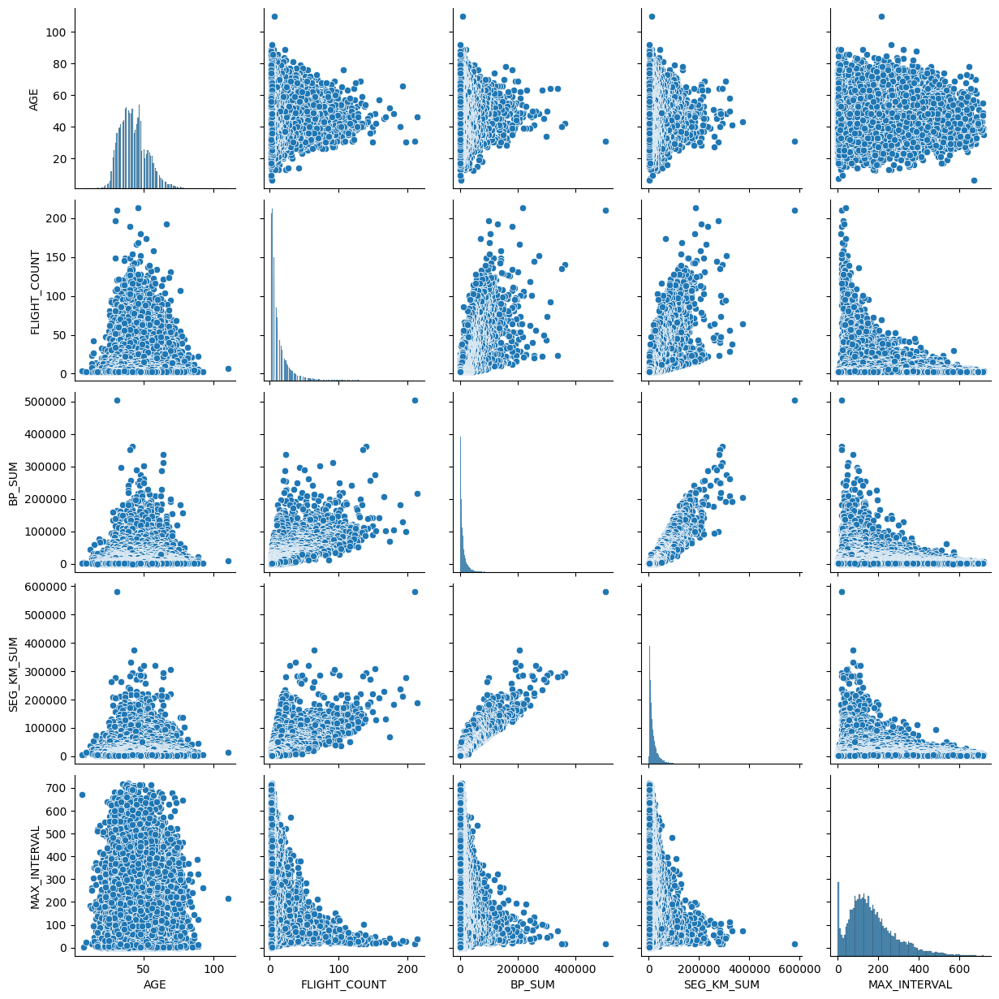

In [45]:
nume_data_plot = data[['AGE','FLIGHT_COUNT','BP_SUM','SEG_KM_SUM','MAX_INTERVAL']]
sns.pairplot(nume_data_plot)
plt.show()

# Null percentage

In [46]:
null_perc = (data.isnull().mean()*100).round(2)

In [47]:
pd.DataFrame({'columns': null_perc.index, 'Null_Percentage': null_perc.values}).sort_values('Null_Percentage', ascending=False)

,columns,Null_Percentage
6,WORK_PROVINCE,5.06
5,WORK_CITY,3.57
15,LAST_FLIGHT_DATE,0.73
8,AGE,0.62
12,SUM_YR_1,0.48
13,SUM_YR_2,0.11
7,WORK_COUNTRY,0.04
3,GENDER,0.01
0,MEMBER_NO,0.00
1,FFP_DATE,0.00


In [48]:
data = data.dropna()
data

,MEMBER_NO,FFP_DATE,FIRST_FLIGHT_DATE,GENDER,FFP_TIER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY,AGE,LOAD_TIME,...,SUM_YR_2,SEG_KM_SUM,LAST_FLIGHT_DATE,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
0,54993,2006-11-02,2008-12-24,Male,6,.,beijing,CN,31.0,2014-03-31,...,234188.0,580717,2014-03-31,1,3.483254,18,34,0.961639,619760,50
2,55106,2007-02-01,2007-08-30,Male,6,.,beijing,CN,40.0,2014-03-31,...,164982.0,283712,2014-03-21,11,5.298507,18,20,1.254676,406361,26
3,21189,2008-08-22,2008-08-23,Male,5,Los Angeles,CA,US,64.0,2014-03-31,...,125500.0,281336,2013-12-26,97,27.863636,73,11,1.090870,372204,12
4,39546,2009-04-10,2009-04-15,Male,6,guiyang,guizhou,CN,48.0,2014-03-31,...,130702.0,309928,2014-03-27,5,4.788079,47,27,0.970658,338813,39
5,56972,2008-02-10,2009-09-29,Male,6,guangzhou,guangdong,CN,64.0,2014-03-31,...,76946.0,294585,2014-01-13,79,7.043956,52,10,0.967692,343121,15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54994,5150,2011-02-21,2011-02-21,Male,4,wujin,jiangsu,CN,46.0,2014-03-31,...,1255.0,4237,2014-01-10,82,190.333333,370,0,0.473361,1090,0
54995,33264,2013-01-29,2013-01-29,Male,4,shenzhen,guangdong,CN,32.0,2014-03-31,...,0.0,3453,2013-03-30,368,60.000000,60,0,0.580828,1967,0
54996,3826,2008-11-14,2008-12-12,Male,4,guangzhou,guangdong,CN,56.0,2014-03-31,...,0.0,3820,2013-03-11,387,173.000000,173,0,0.525000,1452,0
54998,16872,2010-06-18,2010-06-18,Female,4,benxishi,liaoningsheng,CN,36.0,2014-03-31,...,2163.0,2596,2014-03-10,22,33.000000,82,0,0.772500,2074,0


# Standardization for all the variables

In [49]:
nume_data_plot_1 = data.select_dtypes(['int64','float64']).columns
nume_data_plot_1
data.head(1)

,MEMBER_NO,FFP_DATE,FIRST_FLIGHT_DATE,GENDER,FFP_TIER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY,AGE,LOAD_TIME,...,SUM_YR_2,SEG_KM_SUM,LAST_FLIGHT_DATE,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
0,54993,2006-11-02,2008-12-24,Male,6,.,beijing,CN,31.0,2014-03-31,...,234188.0,580717,2014-03-31,1,3.483254,18,34,0.961639,619760,50


In [50]:
ss = StandardScaler()
data[nume_data_plot_1] = ss.fit_transform(data[nume_data_plot_1])
data.head(1)

,MEMBER_NO,FFP_DATE,FIRST_FLIGHT_DATE,GENDER,FFP_TIER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY,AGE,LOAD_TIME,...,SUM_YR_2,SEG_KM_SUM,LAST_FLIGHT_DATE,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
0,1.286127,2006-11-02,2008-12-24,Male,4.716289,.,beijing,CN,-1.184479,2014-03-31,...,25.102039,25.995996,2014-03-31,-0.906679,-0.922756,-1.322484,27.72057,1.286884,28.712827,6.158543


# Correlation

In [51]:
corr_data = data[nume_data_plot_1].corr()
corr_data

,MEMBER_NO,FFP_TIER,AGE,FLIGHT_COUNT,BP_SUM,SUM_YR_1,SUM_YR_2,SEG_KM_SUM,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
MEMBER_NO,1.000000,-0.007083,0.003911,-0.003149,-0.003818,-0.005313,-0.002704,-0.003875,-0.003747,0.003044,0.002332,-0.004785,-0.002753,-0.007592,-0.033608
FFP_TIER,-0.007083,1.000000,0.084248,0.590882,0.586910,0.462625,0.617044,0.527095,-0.207815,-0.171241,-0.165064,0.341768,0.258349,0.572761,0.201979
AGE,0.003911,0.084248,1.000000,0.071926,0.103018,0.113694,0.083563,0.086188,-0.023273,-0.024688,-0.001236,0.030396,0.132373,0.077882,-0.085668
FLIGHT_COUNT,-0.003149,0.590882,0.071926,1.000000,0.787115,0.738824,0.791287,0.846791,-0.391249,-0.370119,-0.269422,0.502813,0.106613,0.758289,0.307456
BP_SUM,-0.003818,0.586910,0.103018,0.787115,1.000000,0.846679,0.880096,0.918182,-0.301983,-0.284260,-0.215771,0.526125,0.300687,0.936933,0.258169
SUM_YR_1,-0.005313,0.462625,0.113694,0.738824,0.846679,1.000000,0.649434,0.795475,-0.160431,-0.272958,-0.199757,0.484083,0.256073,0.796746,0.247928
SUM_YR_2,-0.002704,0.617044,0.083563,0.791287,0.880096,0.649434,1.000000,0.843634,-0.418173,-0.284508,-0.220647,0.463077,0.220134,0.835187,0.250094
SEG_KM_SUM,-0.003875,0.527095,0.086188,0.846791,0.918182,0.795475,0.843634,1.000000,-0.350154,-0.323753,-0.232560,0.505588,0.070177,0.862840,0.274332
LAST_TO_END,-0.003747,-0.207815,-0.023273,-0.391249,-0.301983,-0.160431,-0.418173,-0.350154,1.000000,-0.072717,-0.282167,-0.164089,0.026437,-0.279752,-0.125387
AVG_INTERVAL,0.003044,-0.171241,-0.024688,-0.370119,-0.284260,-0.272958,-0.284508,-0.323753,-0.072717,1.000000,0.719334,-0.153414,-0.015789,-0.260375,-0.093540


<Axes: >

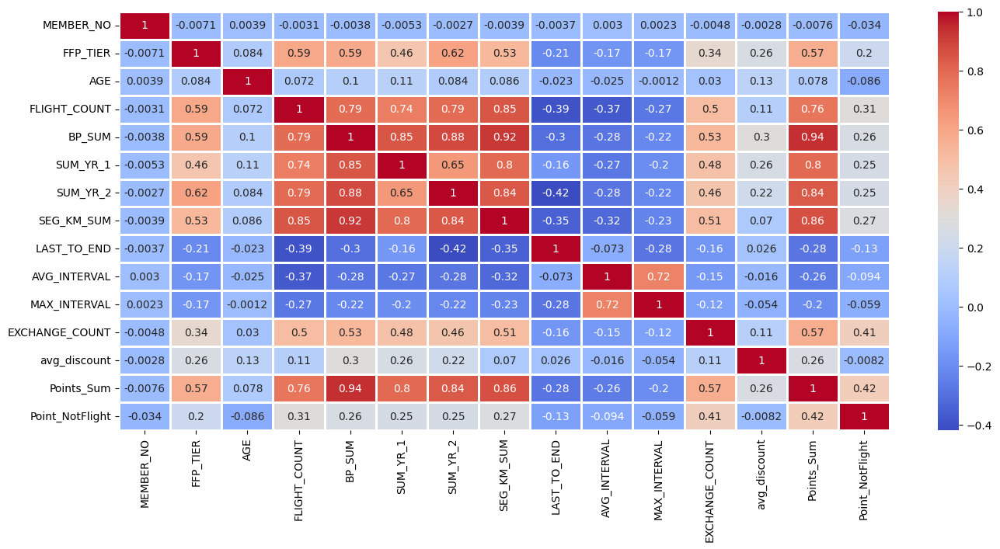

In [52]:
plt.figure(figsize=(16, 7))
sns.heatmap(corr_data, annot=True, cmap='coolwarm', linewidths= 1)

In [53]:
nume_data_plot_1

Index(['MEMBER_NO', 'FFP_TIER', 'AGE', 'FLIGHT_COUNT', 'BP_SUM', 'SUM_YR_1',
       'SUM_YR_2', 'SEG_KM_SUM', 'LAST_TO_END', 'AVG_INTERVAL', 'MAX_INTERVAL',
       'EXCHANGE_COUNT', 'avg_discount', 'Points_Sum', 'Point_NotFlight'],
      dtype='object')

In [54]:
# Based on correlation we pick only 4 columns for clustering
demo_colums_1 = ['AGE','FLIGHT_COUNT','BP_SUM','SEG_KM_SUM']     # Add or remove columns based on correlation matrix or domain knowledge
model_1 = KMeans(n_clusters=3, random_state= 40)
model_1.fit(data[demo_colums_1])

KMeans(n_clusters=3, random_state=40)

In [55]:
data.head(1)                    

,MEMBER_NO,FFP_DATE,FIRST_FLIGHT_DATE,GENDER,FFP_TIER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY,AGE,LOAD_TIME,...,SUM_YR_2,SEG_KM_SUM,LAST_FLIGHT_DATE,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
0,1.286127,2006-11-02,2008-12-24,Male,4.716289,.,beijing,CN,-1.184479,2014-03-31,...,25.102039,25.995996,2014-03-31,-0.906679,-0.922756,-1.322484,27.72057,1.286884,28.712827,6.158543


In [56]:
data['prdicted_cluster'] = model_1.predict(data[demo_colums_1]) 
data_1 = data.copy()
data_1.head()

,MEMBER_NO,FFP_DATE,FIRST_FLIGHT_DATE,GENDER,FFP_TIER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY,AGE,LOAD_TIME,...,SEG_KM_SUM,LAST_FLIGHT_DATE,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight,prdicted_cluster
0,1.286127,2006-11-02,2008-12-24,Male,4.716289,.,beijing,CN,-1.184479,2014-03-31,...,25.995996,2014-03-31,-0.906679,-0.922756,-1.322484,27.720570,1.286884,28.712827,6.158543,2
2,1.292343,2007-02-01,2007-08-30,Male,4.716289,.,beijing,CN,-0.255130,2014-03-31,...,12.241244,2014-03-21,-0.847015,-0.894578,-1.322484,16.180913,2.952359,18.594027,3.019934,2
3,-0.573144,2008-08-22,2008-08-23,Male,2.210440,Los Angeles,CA,US,2.223136,2014-03-31,...,12.131208,2013-12-26,-0.333899,-0.544297,-0.851899,8.762563,2.021366,16.974395,1.189078,2
4,0.436519,2009-04-10,2009-04-15,Male,4.716289,guiyang,guizhou,CN,0.570959,2014-03-31,...,13.455346,2014-03-27,-0.882813,-0.902501,-1.074357,21.950742,1.338142,15.391084,4.720014,2
5,1.394975,2008-02-10,2009-09-29,Male,4.716289,guangzhou,guangdong,CN,2.223136,2014-03-31,...,12.744789,2014-01-13,-0.441296,-0.867483,-1.031577,7.938301,1.321288,15.595358,1.581404,2


In [57]:
data_1.prdicted_cluster.value_counts()

prdicted_cluster
1    27300
0    18333
2     5178
Name: count, dtype: int64

In [58]:
fig = px.scatter(data_1, x='AGE', y='FLIGHT_COUNT',  color='prdicted_cluster')
fig.show()

# PCA analysis model - cluster

In [59]:
data_1[demo_colums_1]

,AGE,FLIGHT_COUNT,BP_SUM,SEG_KM_SUM
0,-1.184479,13.375155,29.121969,25.995996
2,-0.255130,8.273203,20.013846,12.241244
3,2.223136,0.654287,19.195794,12.131208
4,0.570959,9.429645,15.445575,13.455346
5,2.223136,5.348083,17.779136,12.744789
...,...,...,...,...
54994,0.364437,-0.638207,-0.670501,-0.701667
54995,-1.081218,-0.774259,-0.618682,-0.737975
54996,1.397047,-0.774259,-0.649112,-0.720979
54998,-0.668174,-0.638207,-0.612360,-0.777664


In [60]:
pca = PCA(n_components=3)
pca_data = pca.fit_transform(data_1[demo_colums_1])
#Eigen values
pca_data

array([[ 3.94868932e+01, -4.39680488e+00, -1.12085371e+01],
       [ 2.33595523e+01, -2.09843312e+00, -7.18290976e+00],
       [ 1.87807987e+01,  9.07286228e-01, -1.27537973e+01],
       ...,
       [-1.10953625e+00,  1.50223122e+00, -6.78589897e-02],
       [-1.22670421e+00, -5.61457291e-01, -1.59856686e-02],
       [-1.17322588e+00,  6.78454683e-01, -3.24547979e-02]],
      shape=(50811, 3))

In [61]:
len(pca_data[0])

3

In [62]:
data_for_pca = data_1.copy()
data_for_pca.head(1)

,MEMBER_NO,FFP_DATE,FIRST_FLIGHT_DATE,GENDER,FFP_TIER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY,AGE,LOAD_TIME,...,SEG_KM_SUM,LAST_FLIGHT_DATE,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight,prdicted_cluster
0,1.286127,2006-11-02,2008-12-24,Male,4.716289,.,beijing,CN,-1.184479,2014-03-31,...,25.995996,2014-03-31,-0.906679,-0.922756,-1.322484,27.72057,1.286884,28.712827,6.158543,2


In [63]:
data_for_pca['comp_1'] = pca_data[:,0]
data_for_pca['comp_2'] = pca_data[:,1]
data_for_pca['comp_3'] = pca_data[:,2]

In [64]:
data_for_pca

,MEMBER_NO,FFP_DATE,FIRST_FLIGHT_DATE,GENDER,FFP_TIER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY,AGE,LOAD_TIME,...,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight,prdicted_cluster,comp_1,comp_2,comp_3
0,1.286127,2006-11-02,2008-12-24,Male,4.716289,.,beijing,CN,-1.184479,2014-03-31,...,-0.922756,-1.322484,27.720570,1.286884,28.712827,6.158543,2,39.486893,-4.396805,-11.208537
2,1.292343,2007-02-01,2007-08-30,Male,4.716289,.,beijing,CN,-0.255130,2014-03-31,...,-0.894578,-1.322484,16.180913,2.952359,18.594027,3.019934,2,23.359552,-2.098433,-7.182910
3,-0.573144,2008-08-22,2008-08-23,Male,2.210440,Los Angeles,CA,US,2.223136,2014-03-31,...,-0.544297,-0.851899,8.762563,2.021366,16.974395,1.189078,2,18.780799,0.907286,-12.753797
4,0.436519,2009-04-10,2009-04-15,Male,4.716289,guiyang,guizhou,CN,0.570959,2014-03-31,...,-0.902501,-1.074357,21.950742,1.338142,15.391084,4.720014,2,22.158056,-1.274906,-3.969960
5,1.394975,2008-02-10,2009-09-29,Male,4.716289,guangzhou,guangdong,CN,2.223136,2014-03-31,...,-0.867483,-1.031577,7.938301,1.321288,15.595358,1.581404,2,20.948904,0.606699,-8.340347
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54994,-1.455314,2011-02-21,2011-02-21,Male,-0.295409,wujin,jiangsu,CN,0.364437,2014-03-31,...,1.977736,1.689262,-0.304310,-1.488249,-0.622821,-0.380227,0,-1.124963,0.464529,0.024143
54995,0.090999,2013-01-29,2013-01-29,Male,-0.295409,shenzhen,guangdong,CN,-1.081218,2014-03-31,...,-0.045441,-0.963128,-0.304310,-0.877457,-0.581236,-0.380227,1,-1.319239,-0.965693,-0.140197
54996,-1.528136,2008-11-14,2008-12-12,Male,-0.295409,guangzhou,guangdong,CN,1.397047,2014-03-31,...,1.708669,0.003711,-0.304310,-1.194758,-0.605656,-0.380227,0,-1.109536,1.502231,-0.067859
54998,-0.810586,2010-06-18,2010-06-18,Female,-0.295409,benxishi,liaoningsheng,CN,-0.668174,2014-03-31,...,-0.464565,-0.774894,-0.304310,0.211910,-0.576163,-0.380227,1,-1.226704,-0.561457,-0.015986


In [65]:
fig = px.scatter_3d(data_for_pca, x = 'comp_1', y = 'comp_2', z = 'comp_3', color='prdicted_cluster',
                    size= data_for_pca['AGE'].abs(),
                    hover_data=['MEMBER_NO','AGE','GENDER','WORK_CITY','WORK_COUNTRY'])
fig.show()

In [66]:
# Run before only have 23 columns, before standardization
data.shape

(50811, 24)

In [67]:
data['cluster'] = data_for_pca['prdicted_cluster']
data['comp_1'] = data_for_pca['comp_1']
data['comp_2'] = data_for_pca['comp_2']
data['comp_3'] = data_for_pca['comp_3']

In [68]:
fig = px.scatter_3d(data, x = 'comp_1', y = 'comp_2', z = 'comp_3', color='cluster',
                    size= data['AGE'].abs(),
                    hover_data=['MEMBER_NO','AGE','GENDER','WORK_CITY','WORK_COUNTRY'])
fig.show()